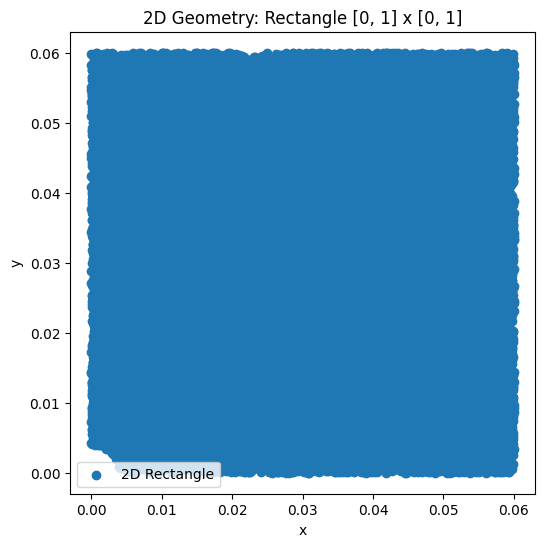

In [5]:
import pandas as pd
from sklearn.model_selection import train_test_split
import numpy as np
import deepxde as dde
import tensorflow as tf
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
from sklearn.metrics import mean_absolute_percentage_error, r2_score

Std=6e-2
Std_s=132075226
t_last= 4.2e5
D_L = 3.8e-11
V_H = 2e-6
RT= 8.314*298
E=200e6
nu=0.3

df = pd.read_excel('Hydrostatic Data with Nodes.xlsx')
X=df.iloc[:,1]
X=np.array(X.tolist()).reshape(-1,1)
Y=df.iloc[:,2]
Y=np.array(Y.tolist()).reshape(-1,1)
S=df.iloc[:,3]
S=np.array(S.tolist()).reshape(-1,1)
Cor=np.column_stack([X,Y])
Cor=Cor
S=S

L = 6e-2
R= 4e-3

square = dde.geometry.Rectangle([0, 0], [L, L])
circle = dde.geometry.Disk([0, 0], R)

geom = dde.geometry.csg.CSGDifference(square, circle)
timedomain = dde.geometry.TimeDomain(0, t_last)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

# Sample points in the geometry
Samp = geom.random_points(30000)

# Visualize the geometry
plt.figure(figsize=(6, 6))
plt.scatter(Samp[:, 0], Samp[:, 1], marker='o', label="2D Rectangle")
plt.title("2D Geometry: Rectangle [0, 1] x [0, 1]")
plt.xlabel("x")
plt.ylabel("y")
plt.legend()
plt.show()



In [16]:
data_points=Cor
grad_sigma_x = []
grad_sigma_y = []
grad_sigma_xx=[]
grad_sigma_yy=[]
sigma_applied=1e5
ic = dde.icbc.IC(geomtime, lambda x: 20, lambda _, on_initial: on_initial, component=5)

def boundary_bottom(x, on_boundary):
    return on_boundary and np.isclose(x[1], 0)
bc_bottom_u_x = dde.DirichletBC(geomtime, lambda x: 0, boundary_bottom, component=0)
bc_bottom_u_y = dde.DirichletBC(geomtime, lambda x: 0, boundary_bottom, component=1)

def boundary_top(x, on_boundary):
    return on_boundary and np.isclose(x[1], L)
bc_top_sigma_yy = dde.icbc.DirichletBC(geomtime, lambda x: sigma_applied, boundary_top, component=3)

bcs =( bc_bottom_u_x, bc_bottom_u_y, bc_top_sigma_yy)
def pde_C_L(x, y):
    
    Coe=(D_L*V_H)/(RT)
    C_L=y[:,5:6]
    # Gradients (u_x = variables[:, 0:1]
    u_x=y[:,0:1]
    u_y = y[:, 1:2]
    sigma_xx = y[:, 2:3]
    sigma_yy = y[:, 3:4]
    sigma_xy = y[:, 4:5]
    
    # Displacement derivatives
    u_x_x = dde.grad.jacobian(u_x, x, i=0, j=0)
    u_x_y = dde.grad.jacobian(u_x, x, i=0, j=1)
    u_y_x = dde.grad.jacobian(u_y, x, i=0, j=0)
    u_y_y = dde.grad.jacobian(u_y, x, i=0, j=1)
    
    # Strains
    eps_xx = u_x_x
    eps_yy = u_y_y
    gamma_xy = u_x_y + u_y_x
    
    # Constitutive relations residuals
    c1 = sigma_xx - (E / (1 - nu ** 2)) * (eps_xx + nu * eps_yy)
    c2 = sigma_yy - (E / (1 - nu ** 2)) * (eps_yy + nu * eps_xx)
    c3 = sigma_xy - (E / (2 * (1 + nu))) * gamma_xy
    
    # Equilibrium equations
    sigma_xx_x = dde.grad.jacobian(sigma_xx, x, i=0, j=0)
    sigma_xy_y = dde.grad.jacobian(sigma_xy, x, i=0, j=1)
    sigma_xy_x = dde.grad.jacobian(sigma_xy, x, i=0, j=0)
    sigma_yy_y = dde.grad.jacobian(sigma_yy, x, i=0, j=1)

    GS = 0.5 * (sigma_xx + sigma_yy)

    dC_L_dt = dde.grad.jacobian(C_L, x, i=0, j=2)  # ∂C_L/∂t (time derivative)
    CL_x=dde.grad.jacobian( C_L, x, i=0, j=0)
    CL_y=dde.grad.jacobian( C_L, x, i=0, j=1)
    CL_x2=dde.grad.hessian( C_L, x, i=0, j=0)
    CL_y2=dde.grad.hessian( C_L, x, i=0, j=1)
    grad_sigma_x2=dde.grad.jacobian(GS,x,i=0,j=0)
    grad_sigma_y2= dde.grad.jacobian(GS,x,i=0,j=1)
    grad_sigma_xx2=dde.grad.hessian(GS,x,i=0,j=0)
    grad_sigma_yy2=dde.grad.hessian(GS,x,i=0,j=1)
    grad_sigma_t=dde.grad.jacobian(GS,x,i=0,j=2)
    
    eq1 =dC_L_dt - D_L*(CL_x2+CL_y2)+(Coe)*(CL_x* grad_sigma_x2+C_L* grad_sigma_xx2+CL_y* grad_sigma_y2+C_L*grad_sigma_yy2)
    eq2= grad_sigma_t
    eq3 = sigma_xx_x + sigma_xy_y
    eq4 = sigma_xy_x + sigma_yy_y
    return [eq1, eq2, eq3, eq4,c1,c2,c3]

data = dde.data.TimePDE(
    geomtime,
    pde_C_L, [ic,bc_bottom_u_x, bc_bottom_u_y, bc_top_sigma_yy],
    num_boundary=400,
    num_initial=700,
    num_test=500,
    )

# Network for C_L
layer_size = [3] + [64] * 8 + [6]  
activation = "tanh"
initializer = "Glorot uniform"
net_C_L = dde.nn.FNN(layer_size, activation, initializer)

model= dde.Model(data, net_C_L)

model.compile("adam", lr=1e-5)
# Define the model with the PDE, initial and boundary conditions

# Add the callback when training the model
losshistory, train_state = model.train(epochs=80000, display_every=1000)

# Optionally plot and save results
dde.saveplot(losshistory, train_state, issave=True, isplot=True)

Compiling model...
Building feed-forward neural network...
'build' took 0.069344 s



c:\Users\yesda\Documents\GitHub\PINN_testing\.conda\Lib\site-packages\deepxde\nn\tensorflow_compat_v1\fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


'compile' took 2.370406 s

Training model...

0         [1.44e-04, 9.22e-04, 1.07e-01, 5.25e-02, 9.72e+13, 2.12e+15, 1.32e+13, 3.99e+02, 2.47e-02, 1.43e-02, 1.00e+10]    [7.49e-14, 6.37e-14, 2.06e-13, 4.76e-10, 1.79e+06, 2.39e+06, 1.23e+04, 3.99e+02, 2.47e-02, 1.43e-02, 1.00e+10]    []  
1000      [4.27e-08, 8.52e-07, 7.74e-02, 3.17e-02, 1.12e+09, 1.41e+09, 1.88e+08, 3.98e+02, 1.40e-02, 1.49e-02, 1.00e+10]    [1.48e-14, 1.11e-16, 1.14e-10, 1.27e-10, 6.83e+02, 6.04e+00, 6.19e+03, 3.98e+02, 1.40e-02, 1.49e-02, 1.00e+10]    []  
2000      [5.00e-06, 5.44e-05, 7.77e-02, 3.36e-02, 8.81e+08, 1.05e+09, 1.71e+08, 3.98e+02, 1.21e-02, 1.32e-02, 1.00e+10]    [7.51e-15, 1.52e-16, 6.43e-11, 6.11e-11, 3.78e+02, 2.36e+00, 3.40e+03, 3.98e+02, 1.21e-02, 1.32e-02, 1.00e+10]    []  
3000      [4.65e-06, 6.17e-05, 7.81e-02, 3.58e-02, 6.18e+08, 6.52e+08, 1.57e+08, 3.97e+02, 1.03e-02, 1.17e-02, 1.00e+10]    [3.60e-15, 1.88e-16, 3.54e-11, 2.79e-11, 2.22e+02, 1.09e+00, 1.90e+03, 3.97e+02, 1.03e-02, 1.17e-02, 

KeyboardInterrupt: 

     node         x         y       sigma
0  node_1  0.014598  0.014112  43584350.6
1  node_2  0.014598  0.016107  43195861.8
2  node_3  0.014598  0.018102  42957984.9
3  node_4  0.014598  0.020097  42829105.4
4  node_5  0.014598  0.022093  42774711.6
X coordinates: [[0.014598  ]
 [0.014598  ]
 [0.014598  ]
 ...
 [0.0013522 ]
 [0.00126786]
 [0.00211575]]
Y coordinates: [[0.014112  ]
 [0.01610713]
 [0.01810226]
 ...
 [0.0049515 ]
 [0.00508507]
 [0.00575253]]
[0.   0.01 0.02 0.03 0.04 0.05 0.06 0.07 0.08 0.09 0.1  0.11 0.12 0.13
 0.14 0.15 0.16 0.17 0.18 0.19 0.2  0.21 0.22 0.23 0.24 0.25 0.26 0.27
 0.28 0.29 0.3  0.31 0.32 0.33 0.34 0.35 0.36 0.37 0.38 0.39 0.4  0.41
 0.42 0.43 0.44 0.45 0.46 0.47 0.48 0.49 0.5  0.51 0.52 0.53 0.54 0.55
 0.56 0.57 0.58 0.59 0.6  0.61 0.62 0.63 0.64 0.65 0.66 0.67 0.68 0.69
 0.7  0.71 0.72 0.73 0.74 0.75 0.76 0.77 0.78 0.79 0.8  0.81 0.82 0.83
 0.84 0.85 0.86 0.87 0.88 0.89 0.9  0.91 0.92 0.93 0.94 0.95 0.96 0.97
 0.98 0.99 1.  ]
(4001,)
(4001,)
(101,)
P

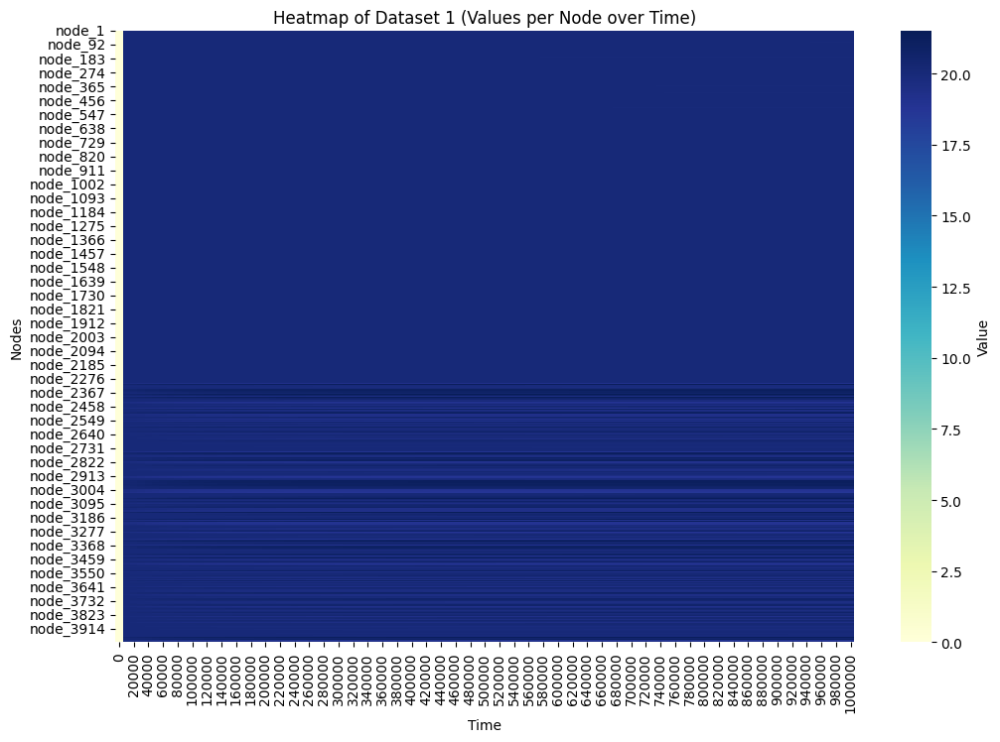

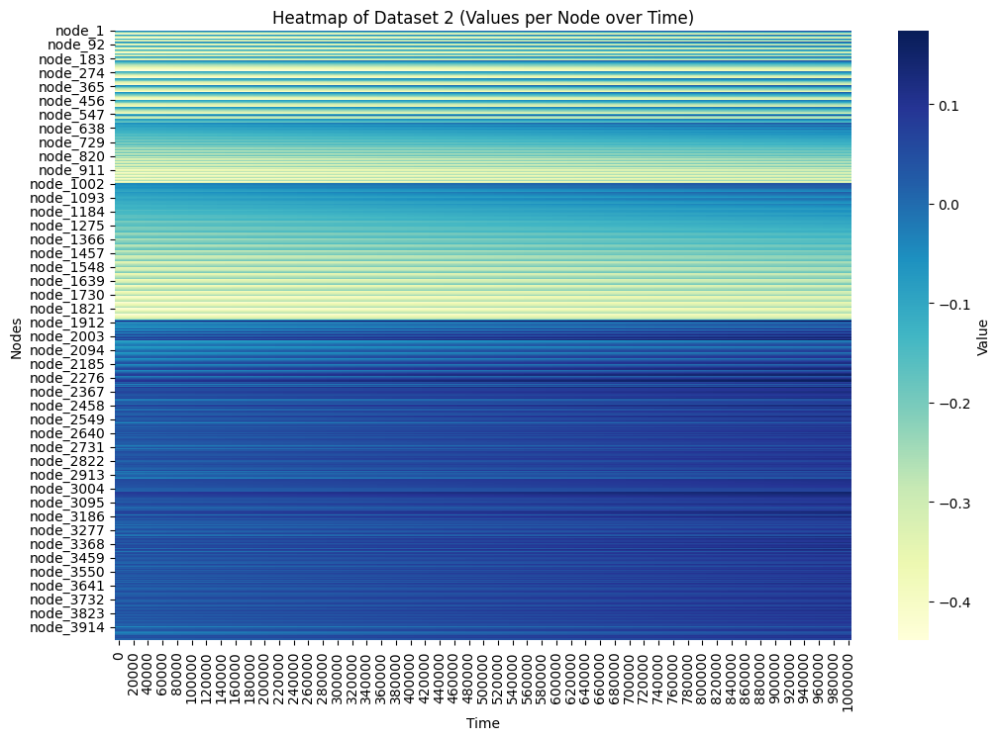

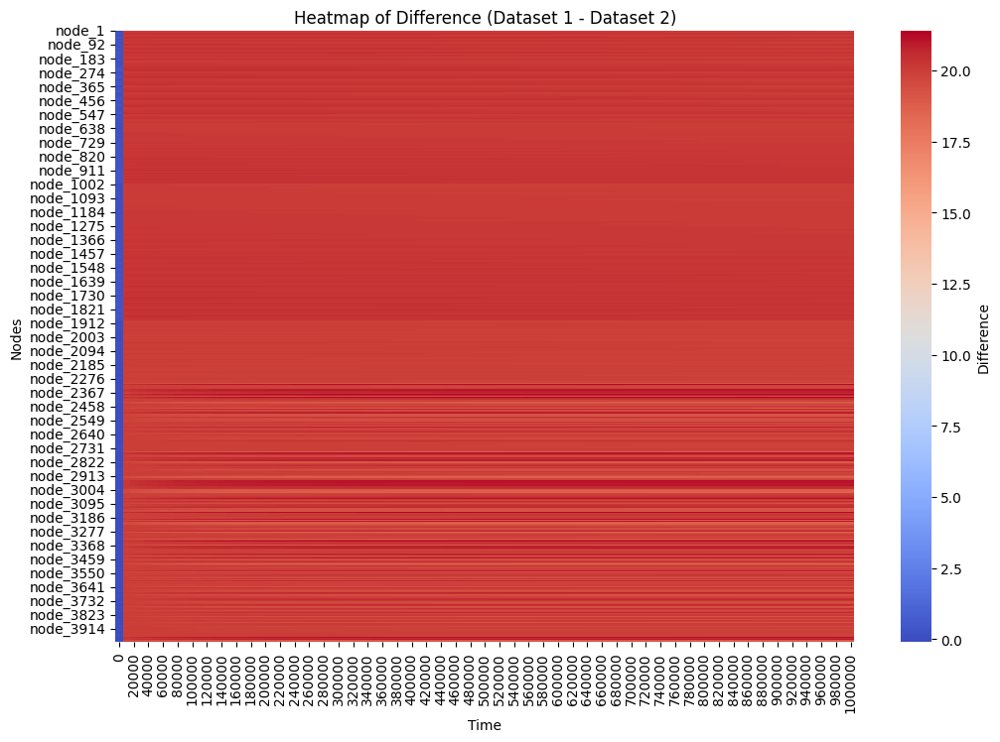

In [17]:
import pandas as pd

# Load the coordinates file (Excel or CSV)
# For Excel:
coordinates_df = pd.read_excel('Hydrostatic Data with Nodes.xlsx') 

# Display the first few rows to verify the data
print(coordinates_df.head())

# Assuming the file has columns named 'x' and 'y'
x_coords = np.array(coordinates_df['x'].values).reshape(-1,1)
y_coords = np.array(coordinates_df['y'].values).reshape(-1,1)

# Verify the extracted coordinates
print("X coordinates:", x_coords)
print("Y coordinates:", y_coords)

scaler_1=StandardScaler()
x_coords=scaler_1.fit_transform(x_coords)
scaler_2=StandardScaler()
y_coords=scaler_2.fit_transform(y_coords)

# Load Excel data (or CSV for demonstration purposes)
df = pd.read_excel('hydrogen_concentration.xlsx') 
time = df['time'].values
time=np.array(time.tolist())/1000000
print(time)
x_coords = np.ravel(np.array(x_coords).reshape([1,-1]))
print(x_coords.shape)
y_coords = np.ravel(np.array(y_coords).reshape([1,-1]))
print(y_coords.shape)
time_steps = np.ravel(np.array(time).reshape([1,-1]))  # Example time steps
print(time_steps.shape)

predictions = np.zeros((len(x_coords), len(y_coords), len(time_steps)))

# Loop through each time step
for t_idx, t in enumerate(time_steps):
    # Loop through all (x, y) combinations
    for i, (x, y) in enumerate(zip(x_coords, y_coords)):
        input_data = np.array([x, y,t]) 
        #print(f"Predicting for x={x}, y={y}, t={t} (normalized: {test_time})")
        # Make the prediction for this (x, y, t) combination
        prediction = model.predict([input_data])[0][0]
        print(f"Prediction for (x={x}, y={y}, t={t}): {prediction}")
        # Extract the scalar prediction value (ensure it's not a sequence)
        
        predictions[:,i,t_idx]=prediction
        # Store the prediction in the correct location
predictions=np.array(predictions[0]).T        
print(predictions)  

import os
def delete_file(filepath):
    # Check if the file exists
    if os.path.exists(filepath):
        try:
            # Delete the file
            os.remove(filepath)
            print(f"File {filepath} successfully deleted.")
        except Exception as e:
            print(f"Error deleting file {filepath}: {e}")
    else:
        print(f"File {filepath} does not exist.")
filepath = "predictions_output.xlsx"

# Delete the file
delete_file(filepath)

print(predictions)
# Flatten the x_coords and y_coords arrays for labeling the columns
x_coords_flat = np.ravel(x_coords)
y_coords_flat = np.ravel(y_coords)

# Prepare column labels as "(x, y)" pairs
column_labels = [f"node_{i+1}" for i in range(len(x_coords_flat))]

# Prepare data for Excel: each row corresponds to a time step, each column to an (x, y) node

# Create a Pandas DataFrame with time steps as rows and (x, y) as columns
df = pd.DataFrame(predictions, columns=column_labels)

# Add a "Time" column to label the time steps
df.insert(0,"time", (time_steps.flatten())*1000000)

# Export the DataFrame to an Excel file
df.to_excel("predictions_output.xlsx", index=False)

print("Data has been successfully exported to predictions_output.xlsx")


from sklearn.metrics import mean_squared_error, mean_absolute_error

# Load the two Excel files, skipping the first row and first column
df1 = pd.read_excel('hydrogen_concentration.xlsx').iloc[2:, 1:]
df2 = pd.read_excel('predictions_output.xlsx').iloc[2:, 1:]

# Ensure the data is aligned by resetting the indices
df1 = df1.reset_index(drop=True)
df2 = df2.reset_index(drop=True)

# Convert the dataframes to NumPy arrays for easy comparison
data1 = df1.to_numpy()
data2 = df2.to_numpy()

# Calculate similarity metrics
mse = mean_squared_error(data1, data2)
mae = mean_absolute_error(data1, data2)

# Print the results
print(f"Mean Squared Error (MSE): {mse}")
print(f"Mean Absolute Error (MAE): {mae}")

# Optionally, compute element-wise absolute differences
difference = abs(data1 - data2)
print(f"Max Absolute Difference: {difference.max()}")

import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
df3 = pd.read_excel('hydrogen_concentration.xlsx')  # First dataset
df4 = pd.read_excel('predictions_output.xlsx')  # Second dataset



# Heatmap for Dataset 1
plt.figure(figsize=(12, 8))
sns.heatmap(df3.set_index('time').T, cmap="YlGnBu", cbar_kws={'label': 'Value'})
plt.title("Heatmap of Dataset 1 (Values per Node over Time)")
plt.xlabel("Time")
plt.ylabel("Nodes")
plt.show()

# Heatmap for Dataset 2
plt.figure(figsize=(12, 8))
sns.heatmap(df4.set_index('time').T, cmap="YlGnBu", cbar_kws={'label': 'Value'})
plt.title("Heatmap of Dataset 2 (Values per Node over Time)")
plt.xlabel("Time")
plt.ylabel("Nodes")
plt.show()

df_diff = df3.set_index('time') - df4.set_index('time')
# Heatmap for the Difference
plt.figure(figsize=(12, 8))
sns.heatmap(df_diff.T, cmap="coolwarm", cbar_kws={'label': 'Difference'})
plt.title("Heatmap of Difference (Dataset 1 - Dataset 2)")
plt.xlabel("Time")
plt.ylabel("Nodes")
plt.show()

